# 01- Data Exploration

In [111]:
%matplotlib inline

import matplotlib.pyplot as plt
import pandas as pd

from tqdm import tqdm
import os
import boto3
import tifffile as tif
import numpy as np
from itertools import product
from IPython.display import display, HTML
display(HTML("<style>.container { width:90% !important; }</style>"))

In [122]:
DATA_DIR = 'data'
RANDOM_STATE = 42
BUCKET_NAME = 'drivendata-competition-biomassters-public-us'
PREFIX = 'train_features'

In [3]:
train_features = pd.read_csv(os.path.join(DATA_DIR, "features_metadata_FzP19JI.csv"))
train_features.head()

,filename,chip_id,satellite,split,month,size,cksum,s3path_us,s3path_eu,s3path_as,corresponding_agbm
0,0003d2eb_S1_00.tif,0003d2eb,S1,train,September,1049524,3953454613,s3://drivendata-competition-biomassters-public...,s3://drivendata-competition-biomassters-public...,s3://drivendata-competition-biomassters-public...,0003d2eb_agbm.tif
1,0003d2eb_S1_01.tif,0003d2eb,S1,train,October,1049524,3531005382,s3://drivendata-competition-biomassters-public...,s3://drivendata-competition-biomassters-public...,s3://drivendata-competition-biomassters-public...,0003d2eb_agbm.tif
2,0003d2eb_S1_02.tif,0003d2eb,S1,train,November,1049524,1401197002,s3://drivendata-competition-biomassters-public...,s3://drivendata-competition-biomassters-public...,s3://drivendata-competition-biomassters-public...,0003d2eb_agbm.tif
3,0003d2eb_S1_03.tif,0003d2eb,S1,train,December,1049524,3253084255,s3://drivendata-competition-biomassters-public...,s3://drivendata-competition-biomassters-public...,s3://drivendata-competition-biomassters-public...,0003d2eb_agbm.tif
4,0003d2eb_S1_04.tif,0003d2eb,S1,train,January,1049524,2467836265,s3://drivendata-competition-biomassters-public...,s3://drivendata-competition-biomassters-public...,s3://drivendata-competition-biomassters-public...,0003d2eb_agbm.tif


In [ ]:
train_features = pd.read_csv(os.path.join(DATA_DIR, "features_metadata_FzP19JI.csv"))
train_features.head()

In [217]:
import io
from botocore.exceptions import ClientError

BUCKET_NAME = 'drivendata-competition-biomassters-public-us'

s3_client = boto3.client(
    's3',
    aws_access_key_id=os.environ['AWS_ACCESS_KEY_ID'],
    aws_secret_access_key=os.environ['AWS_SECRET_ACCESS_KEY']
)
s3_resource = boto3.resource(
    's3',
    aws_access_key_id=os.environ['AWS_ACCESS_KEY_ID'],
    aws_secret_access_key=os.environ['AWS_SECRET_ACCESS_KEY']
)
s3_bucket = s3_resource.Bucket(BUCKET_NAME)

import calendar
month_map = {month: index for index, month in enumerate(calendar.month_name) if month}

def load_tif_from_s3(s3_bucket, key):
    try:
        object = s3_bucket.Object(key)
        img_data = object.get().get('Body').read()
        return tif.imread(io.BytesIO(img_data))
    except ClientError as ex:
        if ex.response['Error']['Code'] == 'NoSuchKey':
            print("Error: No such key")
            img = None

def load_tifs_from_s3(s3_bucket, keys):
    for key in keys:
        load_tif_from_s3(s3_bucket, key)
        
def load_chip_data_df(df, chip_id=[], satellite=None, month=[]):
    condition = df.chip_id.isin(chip_id)
    if satellite:
        condition &= df.satellite==satellite
    if len(month)>0:
        condition &= df.month.isin(month)
    return df.loc[condition,:]

def load_chip_data(df, s3_bucket, chip_id=[], satellite=None, month=[], load_y=True):
    df_query = load_chip_data_df(df, chip_id, satellite, month)        
    data = []
    for idx, row in tqdm(df_query.iterrows(), position=0, leave=True):
        key = f'{row.split}_features/{row.filename}'
        img = load_tif_from_s3(s3_bucket, key)
        if load_y:
            if row.split=='train':
                key = f'train_agbm/{row.corresponding_agbm}'
                img_y = load_tif_from_s3(s3_bucket, key)
                data.append((row.chip_id, row.satellite, row.month, img, img_y))
            else:
                data.append((row.chip_id, row.satellite, row.month, img, None))
        else:
            data.append((row.chip_id, row.satellite, row.month, img))
    return data

In [213]:
num_chips = 10
chip_id = train_features.chip_id.sample(100, random_state=RANDOM_STATE).unique()[:num_chips]
data = load_chip_data(train_features, s3_bucket, chip_id=chip_id, satellite='S1')

120it [00:37,  2.36it/s]


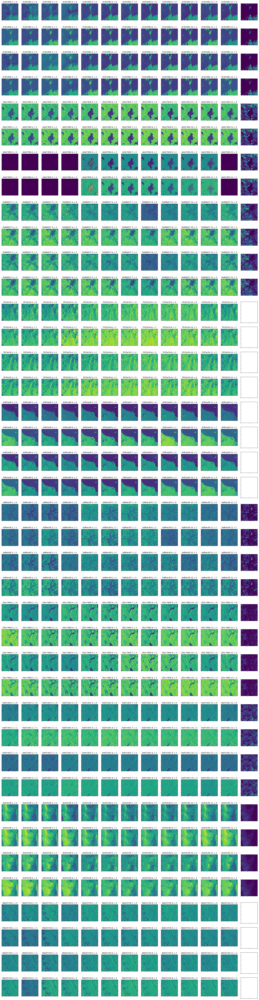

In [214]:
num_channels = 4
num_months = 12
fig, axes = plt.subplots(nrows=num_chips*num_channels, ncols=num_months+1, figsize=(30, 60*num_chips//5))
chip_id_positions = list(set([x[0] for x in data]))

for i, (chip_id, satellite, month, img, img_y) in enumerate(data):
    for channel in range(num_channels):        
        #ii = channel + i//(num_months)*num_channels
        #jj = i%(num_months)
        ii = channel + chip_id_positions.index(chip_id)*num_channels
        jj = month_map.get(month)-1
        ax = axes[ii,jj]
        ax.imshow(img[:,:,channel])
        ax.set_title(f'{chip_id}-{month_map.get(month, month)}, c {channel}')
        ax.xaxis.set_ticklabels([])
        ax.yaxis.set_ticklabels([])
        
        ax = axes[ii,num_months]
        ax.xaxis.set_ticklabels([])
        ax.yaxis.set_ticklabels([])
        if type(img_y) == np.ndarray:    
            ax.imshow(img_y[:,:])


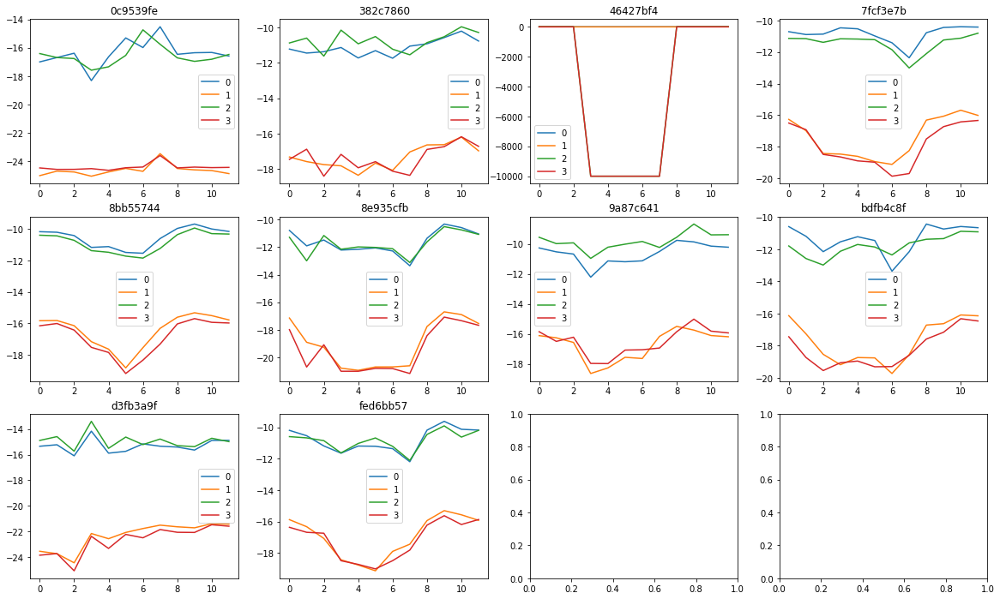

In [215]:
num_channels = 4
fig, axes = plt.subplots(nrows=num_chips//4+ (1 if num_chips % 4 > 0 else 0), ncols=4, figsize=(20, 12))
axes = axes.flatten()

int_data = {}
for i, (chip_id, satellite, month, img, img_y) in enumerate(data):
    for channel in range(num_channels):
        value = np.sum(img[:,:,channel], axis=(0,1))/256**2
        if chip_id in int_data:
            if channel in int_data[chip_id]:
                int_data[chip_id][channel].append(value)
            else:
                int_data[chip_id][channel] = [value]
        else:
            int_data[chip_id] = {channel:[value]}

for i, (chip, chip_data) in enumerate(int_data.items()):
    for j, channel_data in chip_data.items():
        axes[i].plot(range(len(channel_data)), channel_data, label=j)
        axes[i].set_title(chip)
        axes[i].legend()
    

In [218]:
num_chips = 5
chip_id = train_features.chip_id.sample(100, random_state=RANDOM_STATE).unique()[:num_chips]
data_s2 = load_chip_data(train_features, s3_bucket, chip_id=chip_id, satellite='S2')

54it [00:21,  2.08it/s]


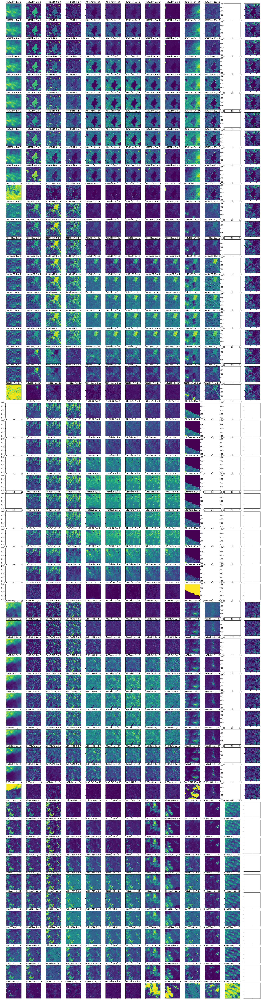

In [219]:
num_channels = 11
num_months = 12
fig, axes = plt.subplots(nrows=num_chips*num_channels, ncols=num_months+1, figsize=(30, 120*num_chips//5))
chip_id_positions = list(set([x[0] for x in data_s2]))

for i, (chip_id, satellite, month, img, img_y) in enumerate(data_s2):
    for channel in range(num_channels):        
        #ii = channel + i//(num_months)*num_channels
        #jj = i%(num_months)
        ii = channel + chip_id_positions.index(chip_id)*num_channels
        jj = month_map.get(month)-1
        ax = axes[ii,jj]
        ax.imshow(img[:,:,channel])
        ax.set_title(f'{chip_id}-{month_map.get(month, month)}, c {channel}')
        ax.xaxis.set_ticklabels([])
        ax.yaxis.set_ticklabels([])
        
        ax = axes[ii,num_months]
        ax.xaxis.set_ticklabels([])
        ax.yaxis.set_ticklabels([])
        if type(img_y) == np.ndarray:    
            ax.imshow(img_y[:,:])


In [220]:
df_s2 = load_chip_data_df(train_features, chip_id=['7fcf3e7b'], satellite='S2')
df_s2

,filename,chip_id,satellite,split,month,size,cksum,s3path_us,s3path_eu,s3path_as,corresponding_agbm
125861,7fcf3e7b_S2_00.tif,7fcf3e7b,S2,test,September,1443550,2505891655,s3://drivendata-competition-biomassters-public...,s3://drivendata-competition-biomassters-public...,s3://drivendata-competition-biomassters-public...,7fcf3e7b_agbm.tif
125862,7fcf3e7b_S2_01.tif,7fcf3e7b,S2,test,October,1443550,2783683489,s3://drivendata-competition-biomassters-public...,s3://drivendata-competition-biomassters-public...,s3://drivendata-competition-biomassters-public...,7fcf3e7b_agbm.tif
125863,7fcf3e7b_S2_05.tif,7fcf3e7b,S2,test,February,1443550,852851632,s3://drivendata-competition-biomassters-public...,s3://drivendata-competition-biomassters-public...,s3://drivendata-competition-biomassters-public...,7fcf3e7b_agbm.tif
125864,7fcf3e7b_S2_06.tif,7fcf3e7b,S2,test,March,1443550,2763476734,s3://drivendata-competition-biomassters-public...,s3://drivendata-competition-biomassters-public...,s3://drivendata-competition-biomassters-public...,7fcf3e7b_agbm.tif
125865,7fcf3e7b_S2_07.tif,7fcf3e7b,S2,test,April,1443550,3304208145,s3://drivendata-competition-biomassters-public...,s3://drivendata-competition-biomassters-public...,s3://drivendata-competition-biomassters-public...,7fcf3e7b_agbm.tif
125866,7fcf3e7b_S2_08.tif,7fcf3e7b,S2,test,May,1443550,848678249,s3://drivendata-competition-biomassters-public...,s3://drivendata-competition-biomassters-public...,s3://drivendata-competition-biomassters-public...,7fcf3e7b_agbm.tif
125867,7fcf3e7b_S2_09.tif,7fcf3e7b,S2,test,June,1443550,1462295651,s3://drivendata-competition-biomassters-public...,s3://drivendata-competition-biomassters-public...,s3://drivendata-competition-biomassters-public...,7fcf3e7b_agbm.tif
125868,7fcf3e7b_S2_10.tif,7fcf3e7b,S2,test,July,1443550,3030617392,s3://drivendata-competition-biomassters-public...,s3://drivendata-competition-biomassters-public...,s3://drivendata-competition-biomassters-public...,7fcf3e7b_agbm.tif
125869,7fcf3e7b_S2_11.tif,7fcf3e7b,S2,test,August,1443550,3403982840,s3://drivendata-competition-biomassters-public...,s3://drivendata-competition-biomassters-public...,s3://drivendata-competition-biomassters-public...,7fcf3e7b_agbm.tif
